# Library

In [17]:
# Ignore the warnings
import warnings
# warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# System related and data input controls
import os

# Python path
import sys
base_folder = 'DataScience'
location_base = os.path.join(os.getcwd().split(base_folder)[0], base_folder)
location_module = [os.path.join(location_base, 'Module')] 
for each in location_module:
    if each not in sys.path:
        sys.path.append(each)

# Auto reload of library
%reload_ext autoreload
%autoreload 2

from import_KK import *
from data_KK import *
DeviceStrategy_CPU()
from preprocessing_KK import *
from preprocessing_text_KK import * ##
from visualization_KK import * ##
from algorithm_textmining_KK import *
from algorithm_machinelearning_KK import *
from algorithm_deeplearning_KK import *
from evaluation_KK import *

# 하이퍼파라미터
DELETE_KEYWORD = ['100세', '거주환경']
CATEGORY_BK = ['경제', '사회', '문화', '국제']
CATEGORY_BK_Sub = ['경제>경제일반', '경제>국제경제', '경제>취업_창업',
                   '사회>노동_복지', '사회>사건_사고', '사회>사회일반', '사회>여성', '사회>장애인', '사회>의료_건강',
                   '문화>미술_건축', '문화>요리_여행', '문화>출판',
                   '국제>중국', '국제>유럽_EU', '국제>일본', '국제>미국_북미', '국제>중동_아프리카',
                   '국제>아시아', '국제>중남미', '국제>국제일반', '국제>러시아']
CATEGORY_CR = ['세계', '경제', '생활/문화', '오피니언', '사회', 'IT/과학']
IMAGE_LOCATION = os.path.join('.', 'Data', 'baby-icon_ver1.png')
COLNAME_CATEGORY = '일자'
COLNAME_MINING = '제목'
# SAVE_LOCATION = r'C:\Users\user\Desktop\Data'    # inu
SAVE_LOCATION = r'C:\Users\KK\Desktop\Data'    # home

# Data Preprocessing

## BigKinds

In [2]:
## 불러오기
df_news = pd.read_csv(os.path.join(SAVE_LOCATION, 'df_news_bigkinds.csv'))
print('Category: ', df_news.Category.value_counts())
keyword_filter = [each for each in df_news['Folder_Name'].unique() if each not in DELETE_KEYWORD]
df_news = df_news[df_news['Folder_Name'].apply(lambda x: x in keyword_filter)].reset_index().iloc[:,1:]
category_filter = [each for each in df_news['통합 분류1'].unique() if each in CATEGORY_BK_Sub]
df_news = df_news[df_news['통합 분류1'].apply(lambda x: x in category_filter)].reset_index().iloc[:,1:]
print('Category: ', df_news.Category.value_counts())

Category:  Category
경제    182058
사회    175598
문화     96737
국제     37249
Name: count, dtype: int64
Category:  Category
사회    143555
경제     46072
국제     35535
문화     21051
Name: count, dtype: int64


In [ ]:
# 불러오기
save_name_list=['word_freq_soynlp.csv', 'wordadj_freq_soynlp.csv', 
                'word_freq_tfidf.csv', 'wordadj_freq_tfidf.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[0])
wf_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[1])
waf_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[2])
wf_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[3])
waf_tfidf = pd.read_csv(save_name)

# 불러오기
save_name_list=['word_freq_soynlp_era.csv', 'wordadj_freq_soynlp_era.csv', 
                'word_freq_tfidf_era.csv', 'wordadj_freq_tfidf_era.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[0])
wf_era_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[1])
waf_era_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[2])
wf_era_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[3])
waf_era_tfidf = pd.read_csv(save_name)

# 불러오기
save_name_list=['word_freq_soynlp_senti.csv', 'wordadj_freq_soynlp_senti.csv', 
                'word_freq_tfidf_senti.csv', 'wordadj_freq_tfidf_senti.csv']
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[0])
wf_senti_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[1])
waf_senti_soynlp = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[2])
# wf_posi_tfidf = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', 'WordFreq_Old', save_name_list[3])
# waf_posi_tfidf = pd.read_csv(save_name)

In [ ]:
# # 관련성 전처리
# wf_corr_soynlp = preprocessing_wordfreq_to_corr(wf_era_soynlp, df_news, colname_target=COLNAME_MINING, colname_category=COLNAME_CATEGORY+'_Era', num_showkeyword=100, save_name='word_corrpair_soynlp_era.csv')
# waf_corr_soynlp = preprocessing_wordfreq_to_corr(waf_era_soynlp, df_news, colname_target=COLNAME_MINING, colname_category=COLNAME_CATEGORY+'_Era', num_showkeyword=100, save_name='wordadj_corrpair_soynlp_era.csv')
# wf_corr_tfidf = preprocessing_wordfreq_to_corr(wf_era_tfidf, df_news, colname_target=COLNAME_MINING, colname_category=COLNAME_CATEGORY+'_Era', num_showkeyword=100, save_name='word_corrpair_tfidf_era.csv')
# waf_corr_tfidf = preprocessing_wordfreq_to_corr(waf_era_tfidf, df_news, colname_target=COLNAME_MINING, colname_category=COLNAME_CATEGORY+'_Era', num_showkeyword=100, save_name='wordadj_corrpair_tfidf_era.csv')

# wf_senti_corr_soynlp = preprocessing_wordfreq_to_corr(wf_senti_soynlp, df_news, colname_target=COLNAME_MINING, colname_category='Sentiment', num_showkeyword=100, save_name='word_corrpair_soynlp_senti.csv')
# waf_senti_corr_soynlp = preprocessing_wordfreq_to_corr(waf_senti_soynlp, df_news, colname_target=COLNAME_MINING, colname_category='Sentiment', num_showkeyword=100, save_name='wordadj_corrpair_soynlp_senti.csv')
# # wf_senti_corr_tfidf = preprocessing_wordfreq_to_corr(wf_senti_tfidf, df_news, colname_target=COLNAME_MINING, colname_category='Sentiment', num_showkeyword=100, save_name='word_corrpair_tfidf_senti.csv')
# # waf_senti_corr_tfidf = preprocessing_wordfreq_to_corr(waf_senti_tfidf, df_news, colname_target=COLNAME_MINING, colname_category='Sentiment', num_showkeyword=100, save_name='wordadj_corrpair_tfidf_senti.csv')


In [ ]:
# 불러오기
save_name_list=['word_corrpair_soynlp_era.csv', 'wordadj_corrpair_soynlp_era.csv', 
                'word_corrpair_tfidf_era.csv', 'wordadj_corrpair_tfidf_era.csv']
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[0])
wf_corr_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[1])
waf_corr_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[2])
wf_corr_tfidf = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[3])
waf_corr_tfidf = pd.read_csv(save_name)

save_name_list=['word_corrpair_soynlp_senti.csv', 'wordadj_corrpair_soynlp_senti.csv', 
                'word_corrpair_tfidf_senti.csv', 'wordadj_corrpair_tfidf_senti.csv']
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[0])
wf_senti_corr_soynlp = pd.read_csv(save_name)
save_name = os.path.join(os.getcwd(), 'Data', save_name_list[1])
waf_senti_corr_soynlp = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[2])
# wf_senti_corr_tfidf = pd.read_csv(save_name)
# save_name = os.path.join(os.getcwd(), 'Data', save_name_list[3])
# waf_senti_corr_tfidf = pd.read_csv(save_name)

## Naver Crawling

In [7]:
# ## 불러오기
# df_news_nv = pd.read_csv(os.path.join(SAVE_LOCATION, 'df_news_crawling.csv'))
# print('Category: ', df_news_nv.Category.value_counts())
# df_newse_nv = pd.read_csv(os.path.join(SAVE_LOCATION, 'df_news_explode_crawling.csv'))

# 구글 검색량 트렌드 예측

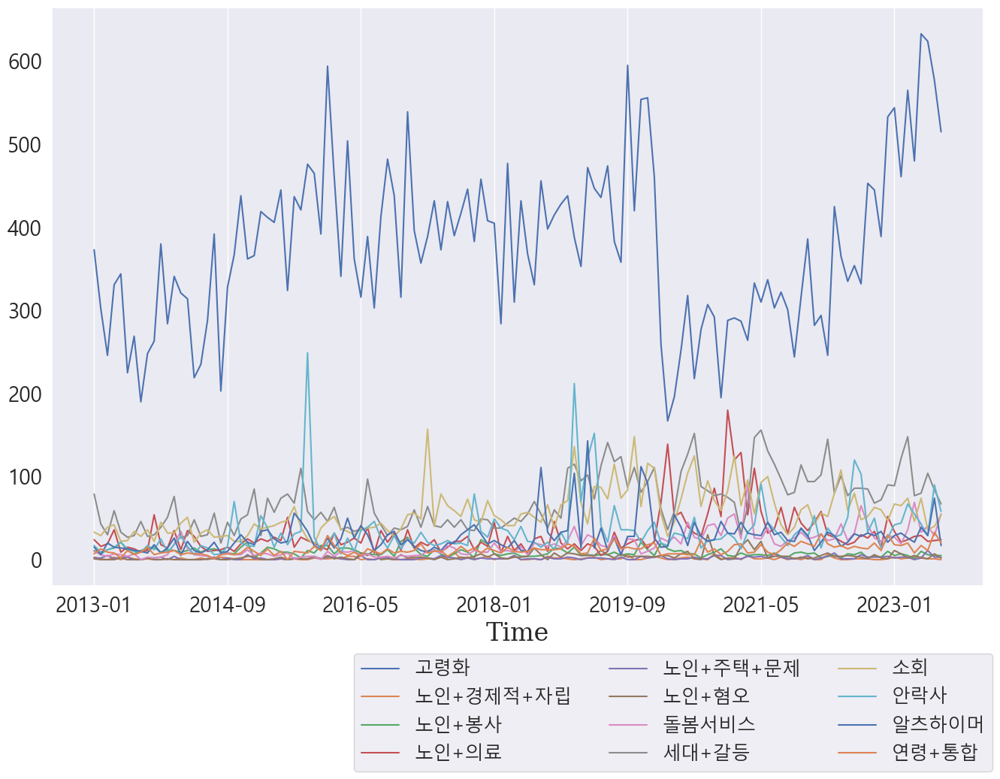

Numerical Scaling... ( 2023-11-04 21:25:14.201858 )


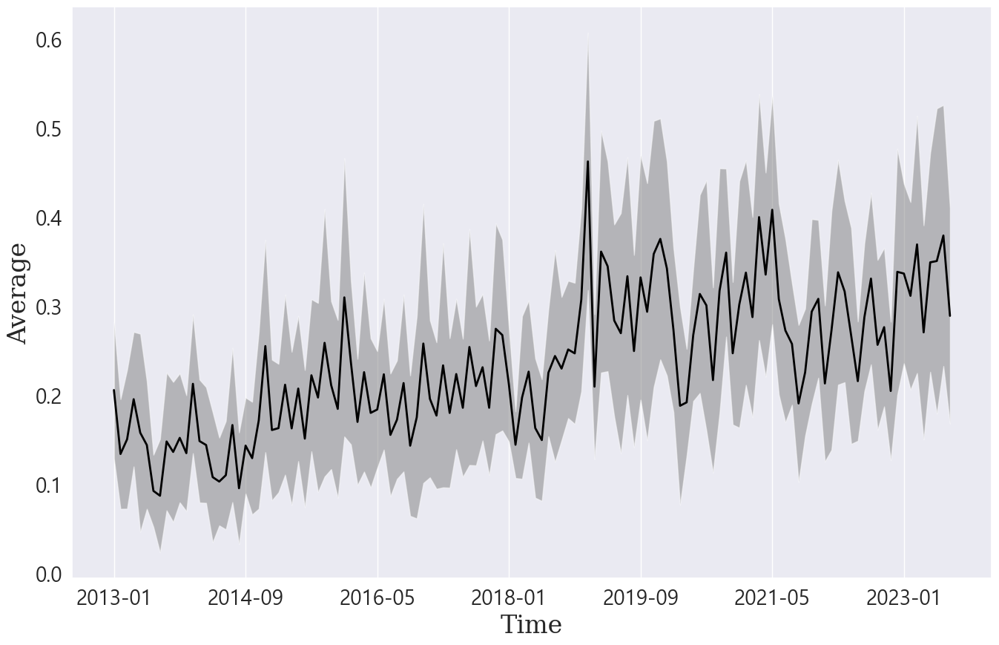

<<< Time Plot Summary >>>


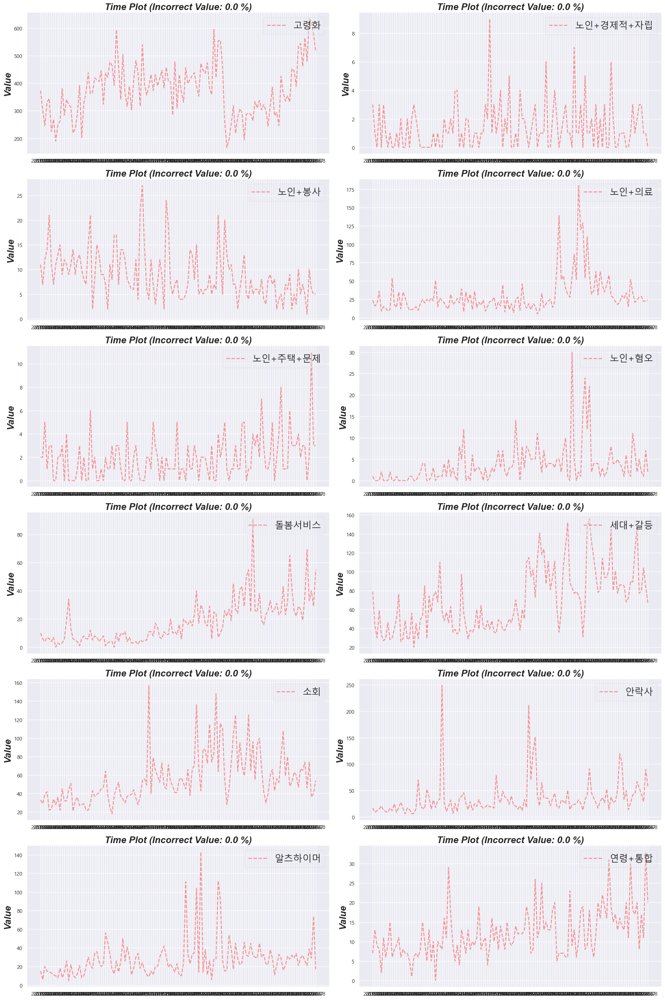

In [20]:
## 증가변수 필터
df_news_rising = df_news.groupby(['Folder_Name', '일자_YearMonth'])['제목'].count().unstack(level=0).fillna(0)
RISING_CATEG = ['고령화', '노인+경제적+자립', '노인+봉사', '노인+의료', 
                '노인+주택+문제', '노인+혐오', '돌봄서비스', '세대+갈등', '소회', 
                '안락사', '알츠하이머', '연령+통합']
df_news_rising = df_news_rising[RISING_CATEG].copy()
## 시각화
plot_timeseries_dforigin(df_news_rising, save_local=True, save_name_initial='gt_total_origin.png')
plot_timeseries_dfmeanstd(df_news_rising, scaled=True, save_local=True, save_name_initial='gt_total_scaled.png')
plot_timeseries(df_news_rising, save_local=True, save_name_initial='gt_each_origin.png')

# 검색어 및 긍부정 트렌드

## 검색어 트랜드: 연도별

In [21]:
# word freq 비교 트랜드 시각화
plot_treemap_wordfreq(wf_soynlp, num_showkeyword=100, title='Ageism by Year', plot_studio=True, save_local=True, save_name='trend_year_compare_treemap.html')
plot_sunburst_wordfreq(waf_soynlp, title='Ageism by Year', plot_studio=True, save_local=True, save_name='trend_year_compare_sunburst.html')
plot_bar_wordfreq(wf_soynlp, figsize=(30,8), num_showkeyword=20, title='Ageism by Year', save_local=True, save_name='trend_year_compare_bar_byword.png')
plot_bar_wordfreq(waf_soynlp, figsize=(30,8), num_showkeyword=20, title='Ageism by Year', save_local=True, save_name='trend_year_compare_bar_bywordadj.png')

JAVA is in the system path?: True


2023-11-04 21:25:45,686	INFO worker.py:1476 -- Calling ray.init() again after it has already been called.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


JAVA is in the system path?: True


2023-11-04 21:25:46,184	INFO worker.py:1476 -- Calling ray.init() again after it has already been called.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


JAVA is in the system path?: True


2023-11-04 21:25:46,699	INFO worker.py:1476 -- Calling ray.init() again after it has already been called.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


JAVA is in the system path?: True


2023-11-04 21:25:47,198	INFO worker.py:1476 -- Calling ray.init() again after it has already been called.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\KK\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


NameError: name 'wf_soynlp' is not defined

## 검색어 트랜드: 시대별

2013 ~ 2017


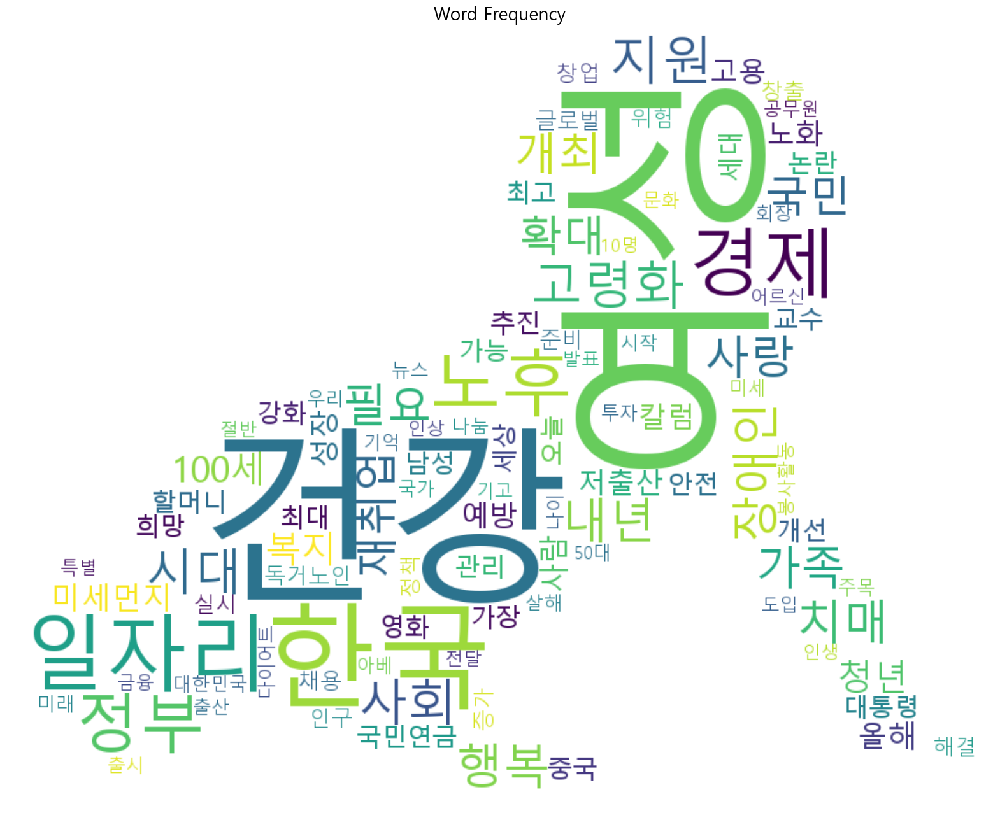

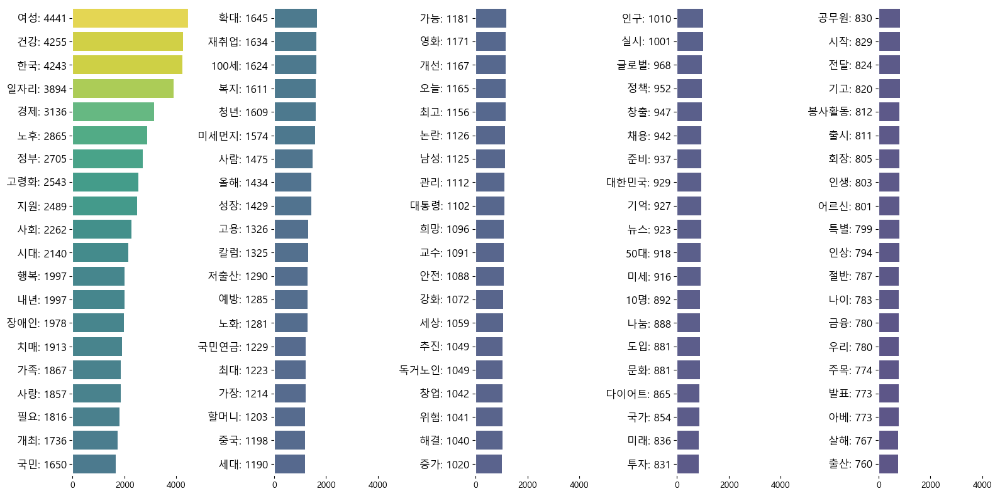

'Descriptive statistics of pairweight: '

,count,mean,std,min,25%,50%,75%,max
correlation,"9,702.0000",0.0007,0.0123,-0.0141,-0.0035,-0.0021,0.0011,0.3758


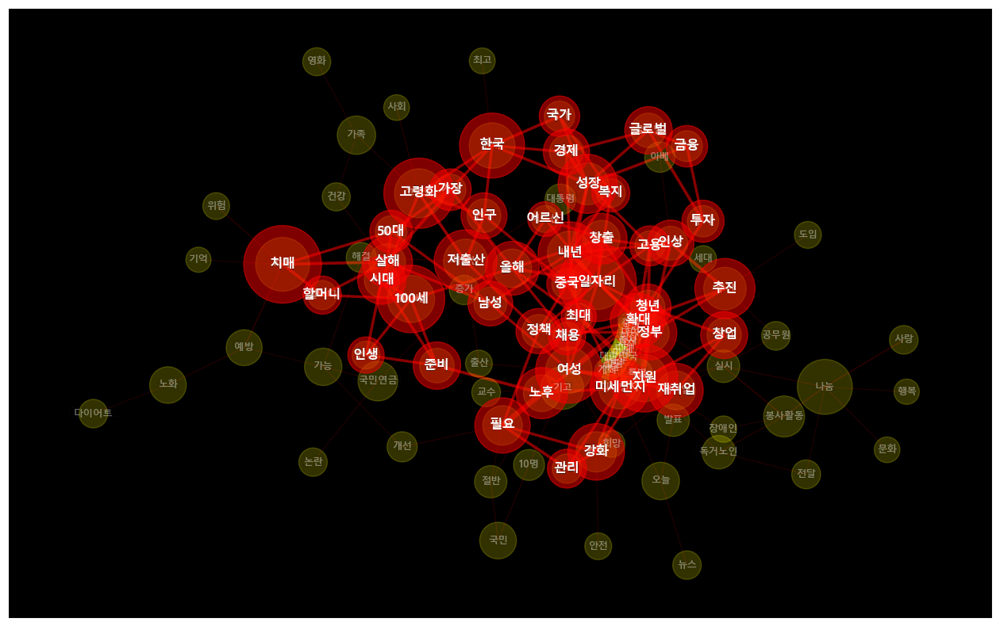

2018 ~ 2023


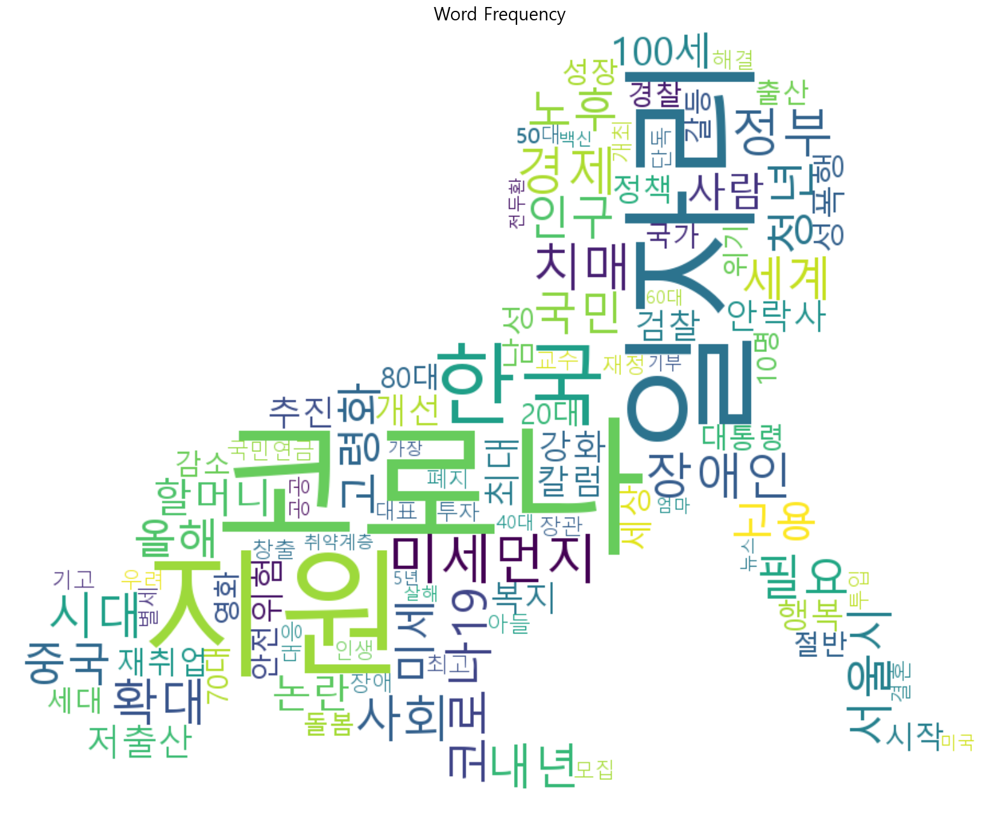

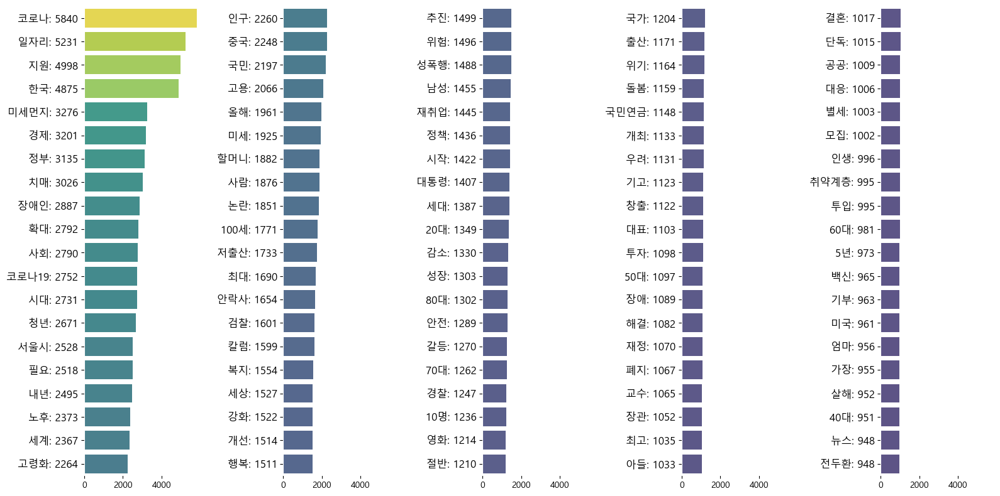

'Descriptive statistics of pairweight: '

,count,mean,std,min,25%,50%,75%,max
correlation,"9,900.0000",0.0011,0.0139,-0.0162,-0.0042,-0.0023,0.0016,0.3283


In [14]:
# 연도별 word freq 시각화
centrality_categ = pd.DataFrame()
for category in wf_era_soynlp[wf_era_soynlp.columns[0]].unique():
    print(category)
    wf_sub = wf_era_soynlp.groupby(wf_era_soynlp.columns[0]).get_group(category)
    wc_sub = wf_corr_soynlp[wf_corr_soynlp.category.isin([category])]
    
    plot_wordcloud(wf_sub.iloc[:,1:], mask_colorgen=False, max_words=100, mask_location=IMAGE_LOCATION, save_local=True, save_name='trend_era_wordcloud_'+'~'.join(category.split(' ~ '))+'.png')
    plot_bar_wordfreq(wf_sub.iloc[:,1:], figsize=(16,8), num_showkeyword=100, title='Ageism by Era', 
                      save_local=True, save_name='trend_era_bar_'+'~'.join(category.split(' ~ '))+'.png')
    plot_donut_wordfreq(wf_sub.iloc[:,1:], num_showkeyword=30, save_local=True, save_name='trend_era_donut_'+'~'.join(category.split(' ~ '))+'.html')
    try:
        _, centrality = plot_networkx(wf_sub, wc_sub.iloc[:,1:], 
                                      filter_criteria=0.02, plot=True, node_size='pagerank', save_local=True, save_name='trend_era_networkx_'+'~'.join(category.split(' ~ '))+'.png')
        ## 카테고리 추가
        centrality['category'] = str(category)
        centrality_categ = pd.concat([centrality_categ, centrality], axis=0, ignore_index=True)
    except:
        pass

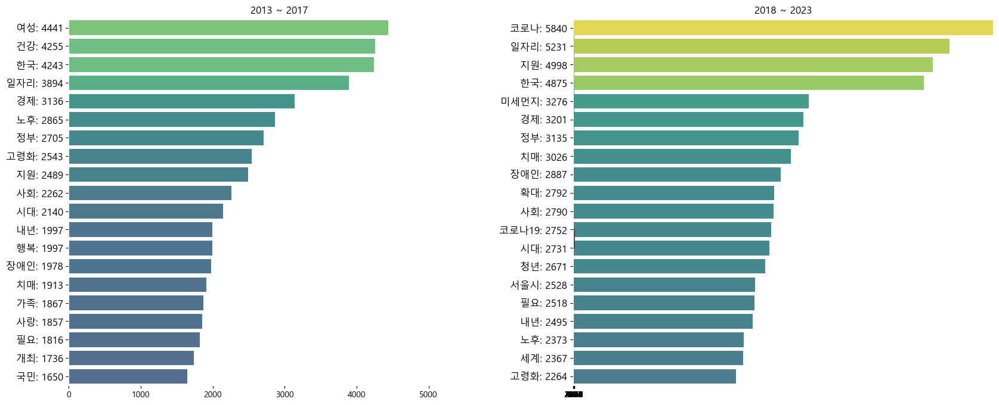

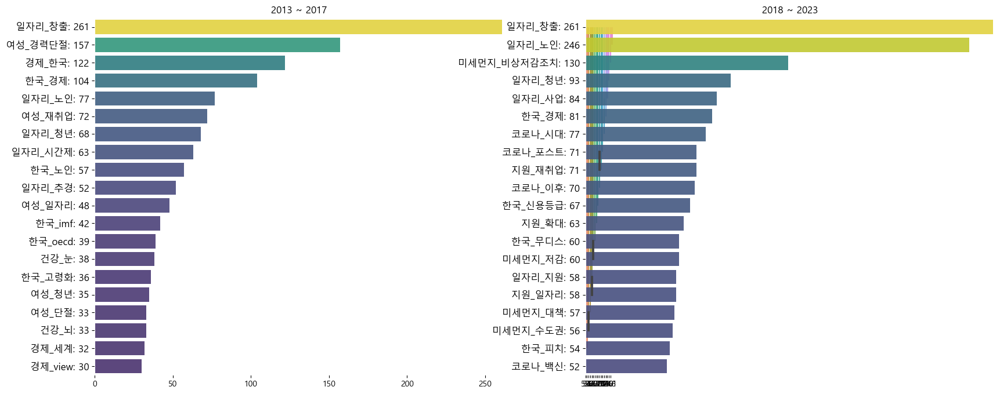

In [15]:
# word freq 비교 트랜드 시각화
plot_treemap_wordfreq(wf_era_soynlp, num_showkeyword=100, title='Ageism_Era', plot_studio=True, save_local=True, save_name='trend_era_compare_treemap_'+'~'.join(category.split(' ~ '))+'.html')
plot_sunburst_wordfreq(waf_era_soynlp, title='Ageism_Era', plot_studio=True, save_local=True, save_name='trend_era_compare_sunburst_'+'~'.join(category.split(' ~ '))+'.html')
plot_bar_wordfreq(wf_era_soynlp, figsize=(20,8), num_showkeyword=20, title='Ageism_Era', save_local=True, save_name='trend_era_compare_bar_byword_'+'~'.join(category.split(' ~ '))+'.png')
plot_bar_wordfreq(waf_era_soynlp, figsize=(20,8), num_showkeyword=20, title='Ageism_Era', save_local=True, save_name='trend_era_compare_bar_bywordadj_'+'~'.join(category.split(' ~ '))+'.png')

## 긍부정 트렌드: 연도별

In [18]:
df_plot = df_news.groupby('일자_YearMonth')[['Positive', 'Negative']].sum()
plot_bar(df_plot, summation=True, title='Ageism Sentiment')

## 긍부정 트렌드: 연도 및 카테고리별

In [13]:
df_plot = df_news.groupby(['Category', '일자_YearMonth'])[['Positive', 'Negative']].sum()
for categ in df_plot.index.get_level_values(0).unique():
    idx_sub = [idx for idx in df_plot.index if idx[0] == categ]
    df_sub = df_plot.loc[idx_sub,:].droplevel(0)
    plot_bar(df_sub, summation=True, title=categ)

## 긍부정 트렌드: 연도 및 세부카테고리별

In [ ]:
df_plot = df_news.groupby(['통합 분류1', '일자_YearMonth'])[['Positive', 'Negative']].sum()
for categ in df_plot.index.get_level_values(0).unique():
    idx_sub = [idx for idx in df_plot.index if idx[0] == categ]
    df_sub = df_plot.loc[idx_sub,:].droplevel(0)
    plot_bar(df_sub, summation=True, title=categ)

## 긍부정 트렌드: 연도 및 키워드별

In [14]:
df_plot = df_news.groupby(['Folder_Name', '일자_YearMonth'])[['Positive', 'Negative']].sum()
for categ in df_plot.index.get_level_values(0).unique():
    idx_sub = [idx for idx in df_plot.index if idx[0] == categ]
    df_sub = df_plot.loc[idx_sub,:].droplevel(0)
    plot_bar(df_sub, summation=True, title=categ)

## 긍부정 기사에 따른 키워드 트랜드 차이

In [15]:
# word freq 비교 트랜드 시각화
plot_treemap_wordfreq(wf_senti_soynlp, num_showkeyword=100, title='Ageism by Sentiment', plot_studio=True, save_local=True, save_name='trend_senti_compare_treemap.html')
plot_sunburst_wordfreq(waf_senti_soynlp, title='Ageism by Sentiment', plot_studio=True, save_local=True, save_name='trend_senti_compare_sunburst.html')